## Mapping Over Time

### Maps, Dots, and Polygons

Here I'll break down each layer and describe what it shows. If you want to see what it looks like for yourself in QGIS, feel free to download the file (Final_Project_Map.qgz) from this Notebook.

<b>Initial Plot</b> - Here we have the white and black populations plotted on a map of Charlotte taken from Google Maps. I did try and see how it would look with the 1911 Sandborne map, but unfortunately most of the population lived outside of that map's boundaries. White individuals are the green diamonds and Black individuals are the blue circles.

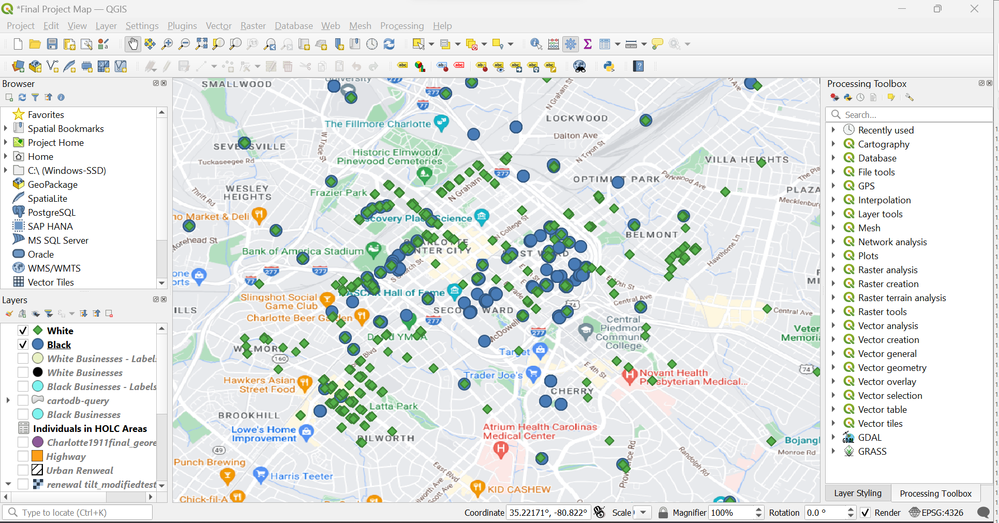

<b>HOLC Overlay</b> - This is the 1937 HOLC map with the 1911 inhabitants plotted on it, separted by race. While most of the addresses fall into a C (yellow) or D (red) zone, you can see where certain neighborhoods are more separated by race.

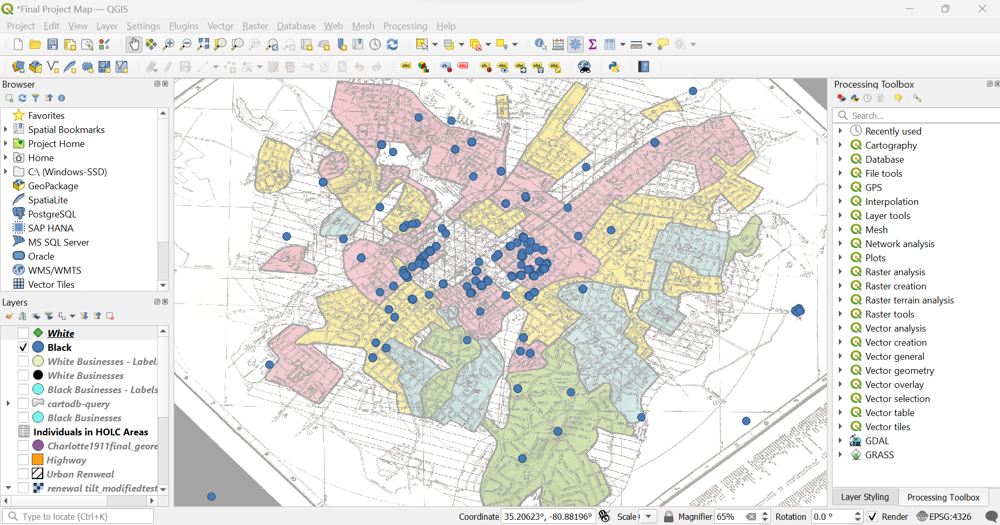
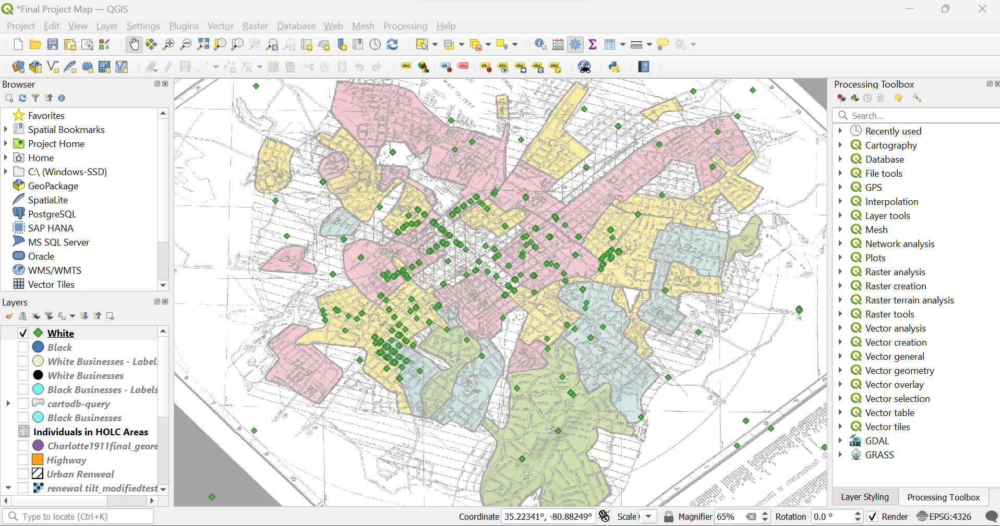

<b>HOLC Geoshapes</b> - Mapping Inequality provided ready made polygons of each area for use in GIS software. After classifying them by color and generating labels, they could be used on other maps without the need to overlay the entire 1937 map.

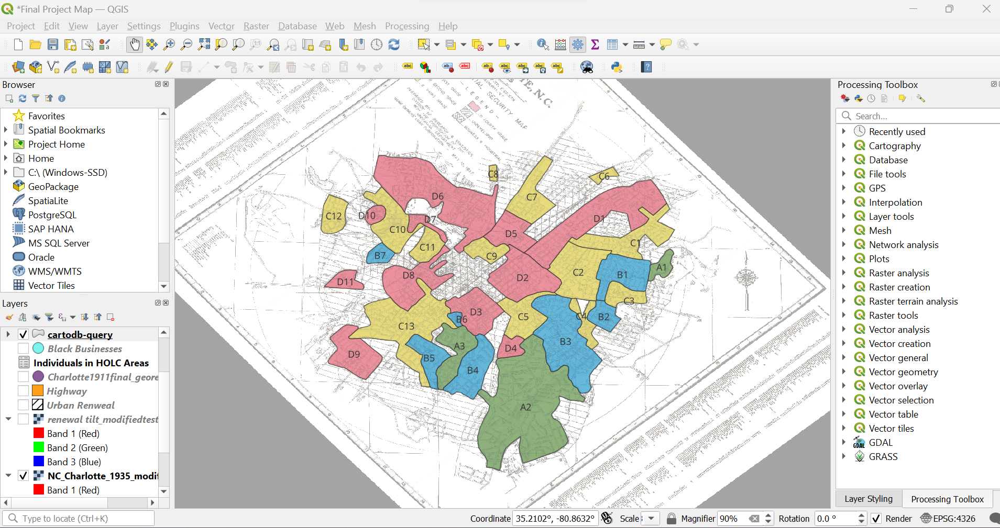

<b>Urban Renewal Overlay</b> - Below is the Urban Renewal map from 1971 with the 1911 population plotted on it, separated by race. There is some correlation between the racial differences among 1911 communities and planned projects, but less so than the redline map. However you can see where people's roots laid down since 1911 were affected by the proposed plans and highway. 

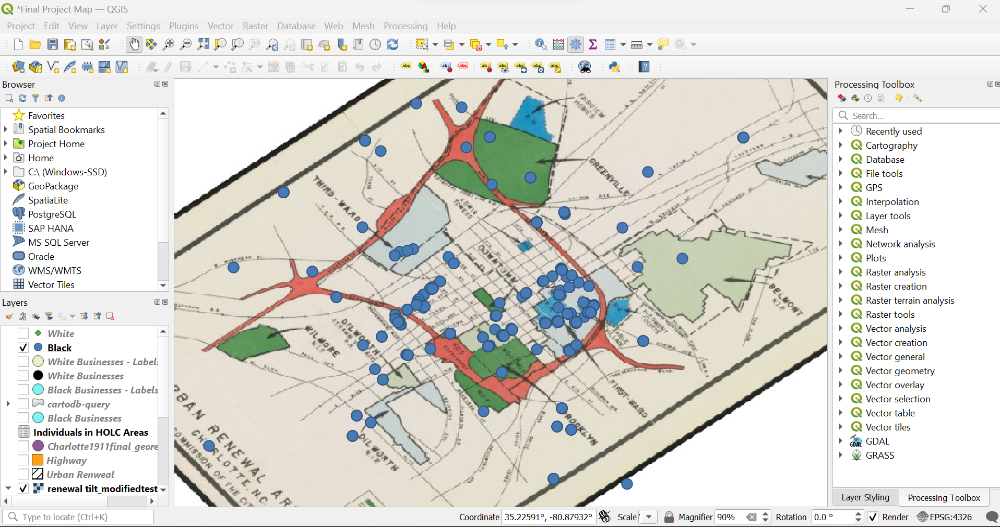
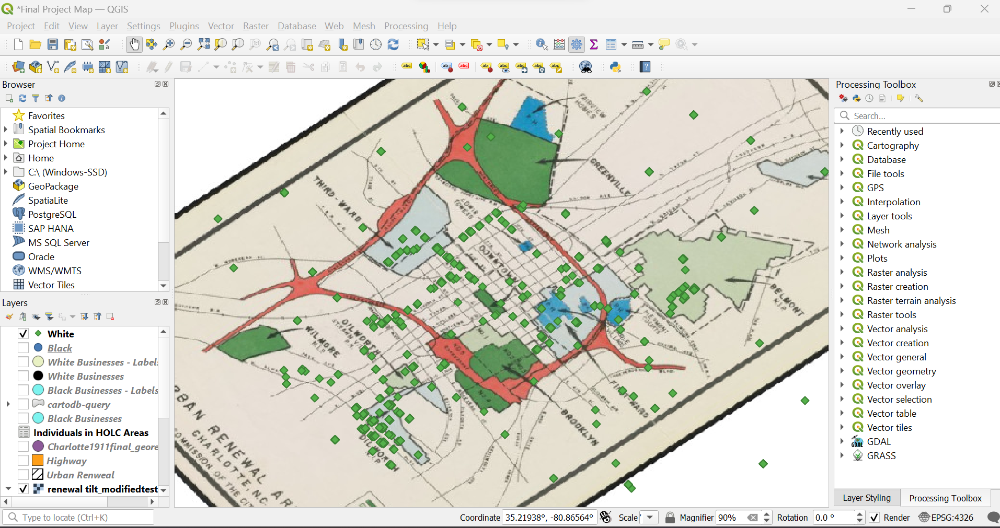

<b>Urban Renewal Polygon Creation</b> - Following Mapping Inequality's example, I created polygons based on each proposed or completed urban renewal project, including the highway. Unfortunately the 1972 map was not perfectly to scale, so the resulting polygons were off when comparing it to other maps of Charlotte. They still do the job, but it does not allow for precise analysis.

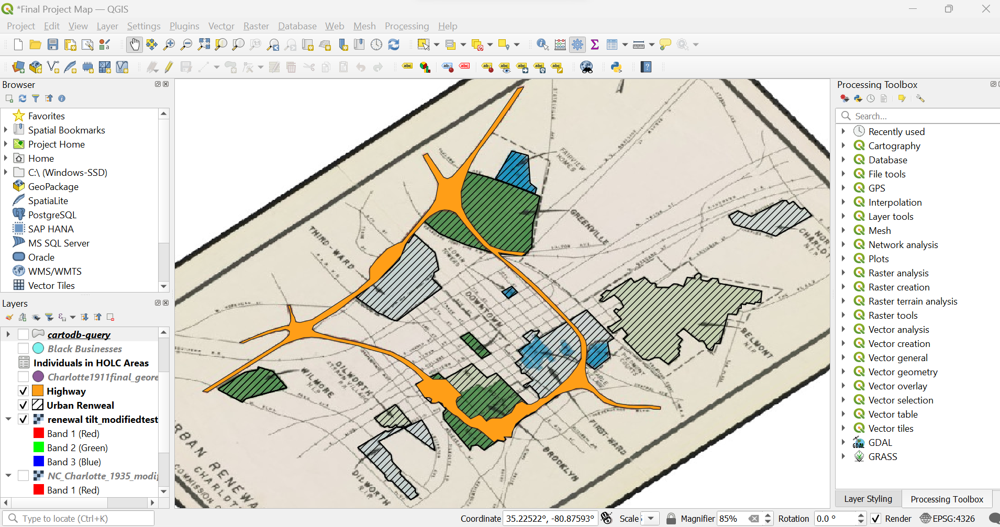

### Combining Everything Together

Here, I combine everything together by overlaying the polygons from the 1937 and 1972 map on top of the 1911 dataset. While the result is admittedly messy, we can see something interesting in that most of the areas with proposed or completed urban renewal projects are in zones graded C (yellow) or D (red), showing that urban renewal mostly targeted low income communities, of which neighborhoods of color saw the worst damage. For example, the majority black neighborhood of Brooklyn, taking up a large portion of the red D3 area, was razed by the city in its first wave of urban renewal. More can be found on the neighborhood [here](https://brooklynvillage-clt.com/history/). We can also see the heavily populated area D2 get a highway built straight through it. I thought it was interesting that it goes directly up against the cluster of black individuals in that area. 

Area B5 is also of interest in that it was graded B by the HOLC and had a historically white population. This makes it an outlier in its selection for urban renewal. It would be interesting to know more about how residents of this area were treated during these projects compared to other residents in Charlotte. 

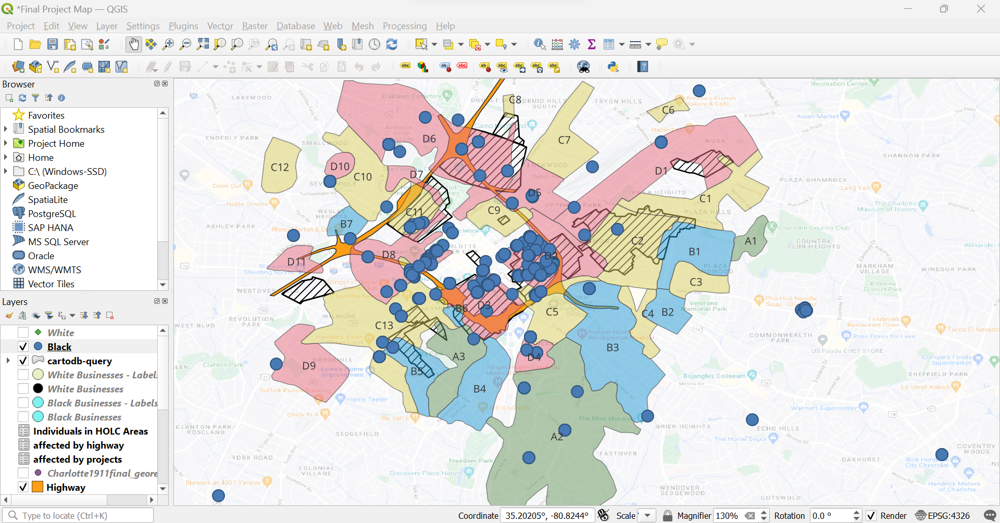
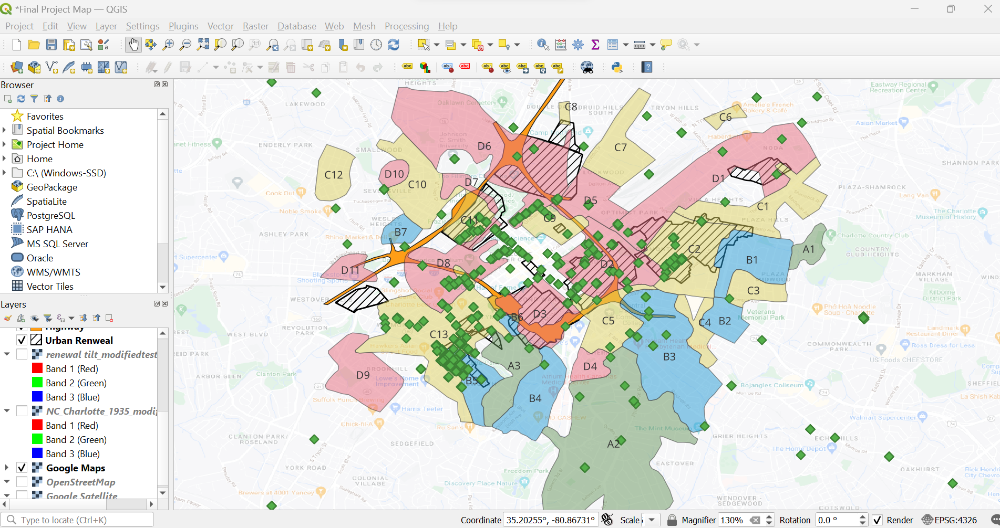

For a cleaner view, here is the map with just the polygons. Here you can see that the polygons I created from the 1972 map don't quite align with the more accurate polygons from the 1937 map. Note the urban renewal project in area C2- the lefthand border is almost the exact same as area B1.

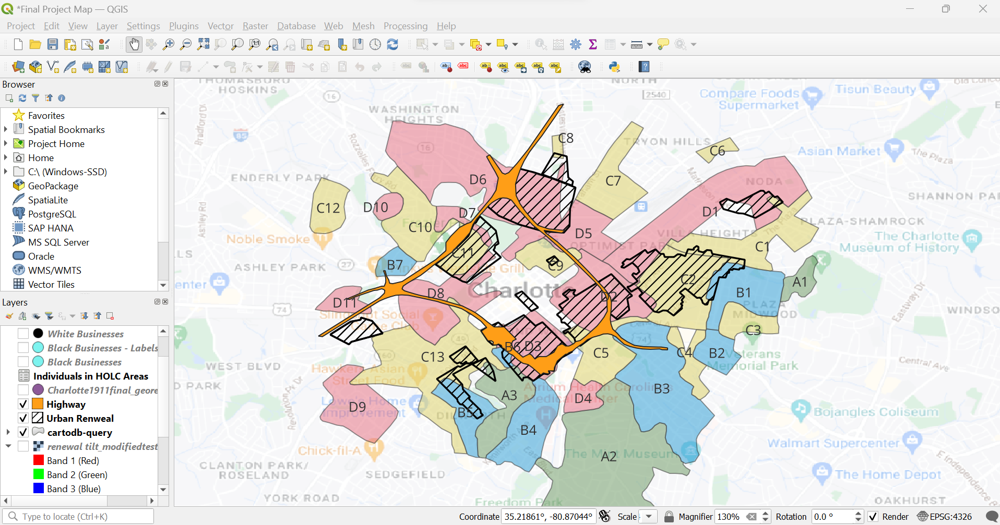

With QGIS, I was able to select the values that were contained within polygons. This let me figure out which individuals from 1911 would have been directly affected by the 1972 urban renewal projects. 

Based on this selection of the available data, 39% were Black and 61% were white. 32% of people in this dataset were Black, indicating a disproportionate effect. It would be interesting to see what the numbers would be with popluation data from the 70's.

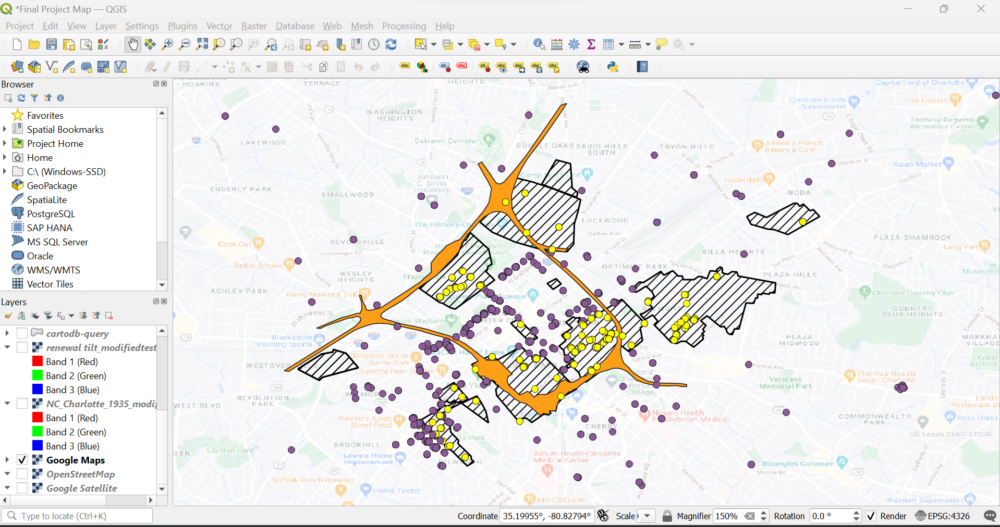

I also created a modified version of the original dataset based on people who lived in HOLC areas. Using the complete 1911 dataset containing all values, I first selected all the indiviuals found in the boundaries of the HOLC polygons. 

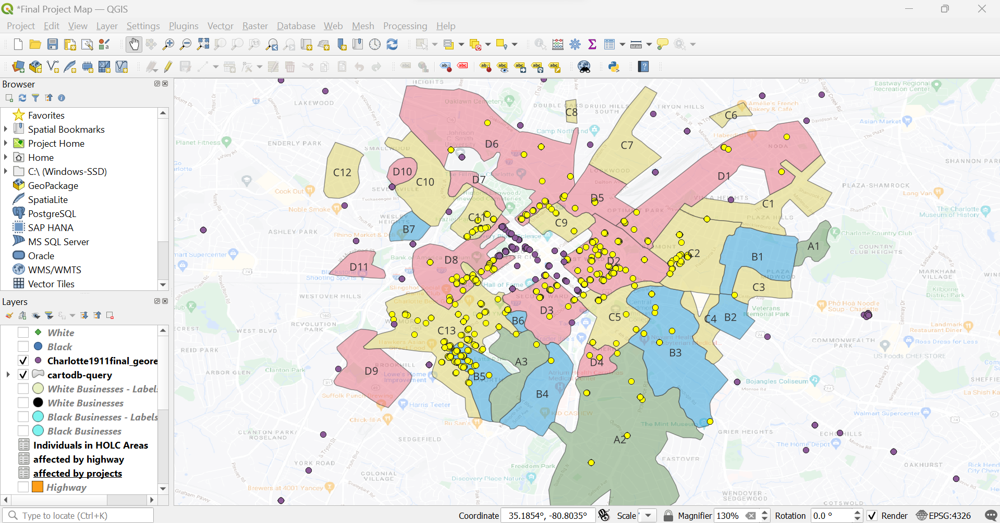

Then, I joined the attributes of the HOLC areas and the 1911 dataset, giving me a .csv file showing each individual living in one of these areas, along with the grade of their area and it's HOLC ID. Below is a sample of the data, but the whole file can be found [here](./dataset_by_holc.csv).

In [13]:
import pandas as pd

data = pd.read_csv("~/work/samsnwilson/sampledata.csv")
data.head()

,wkt_geom,field_1,Orig-copy,Race,Name,Title,Married,Wid,Spouse,BizDir,...,Housing,Address,loc,point,latitude,longitude,altitude,name_2,holc_id,holc_grade
0,Point (-80.82523928145448622 35.20295564999999...,1015,"Belk H G, mill hd, h 502 Mecklenburg Hill",White,Belk H G,NaN,NaN,NaN,NaN,0,...,h 502 Mecklenburg Hill,502 Mecklenburg Hill,"The Mecklenburg, Providence Road, Crescent Hei...","(35.20295565, -80.82523928145449, 0.0)",35.202956,-80.825239,0,NaN,A2,A
1,Point (-80.82323700000000599 35.22049499999999...,7201,"Johnson Jas A (Lula P), cabt mkr, h Sunnyside",White,Johnson Jas A,NaN,NaN,NaN,Lula P,0,...,h Sunnyside,Sunnyside,"Sunnyside Avenue, Elizabeth, Charlotte, Meckle...","(35.220495, -80.823237, 0.0)",35.220495,-80.823237,0,NaN,B3,B
2,Point (-80.85347428632776712 35.22326725819971...,1005,"*Becoat Nathan (Lillie), lab, h 308 w Morehead",Black,Becoat Nathan,NaN,NaN,NaN,Lillie,0,...,h 308 w Morehead,308 w Morehead,"308, West Morehead Street, South End, Charlott...","(35.22326725819972, -80.85347428632777, 0.0)",35.223267,-80.853474,0,NaN,C13,C
3,Point (-80.83142577777778115 35.22771288888888...,1491,"Boyd Mary A Miss, bkkpr The Ben-Vonde Co, h 70...",White,Boyd Mary A,NaN,Miss,NaN,NaN,0,...,h 705 n Davidson,705 n Davidson,"705, North Davidson Street, Uptown, Belmont, C...","(35.22771288888889, -80.83142577777778, 0.0)",35.227713,-80.831426,0,NaN,D2,D


As a quick example of using this data to show the disparity in 1911 that continued into 1937, areas A and B had a lower percentage of its employed residents as laborers (8% and 2%) compared to C and D (12% and 16%). Further analysis on this would be interesting to explore the economic factors of policies like redlining and urban renewal.

I think the most value all of this would have is by applying a similar methodology to a dataset much closer in time to when these policies were happening. However, we were able to see some interesting correlations between historical communities and the policies that affected them, showing the impact that history has on future generations. 

For me, just seeing individual points on a map that represent actual people and their homes helped show the human impact of these policies. Seeing the planned highway go straight through an area where people had lived for decades, clearly dividing a street in two hit me differently than if I had just read about it. 